## 8. Python-Stata Integration
In Stata 17 and later, you can invoke Stata commands from the Python environment via the Python package <b>stata_setup</b> and <b>pystata</b>. Python is very powerful in data manipulation and as a general programming language, but Stata is more powerful in using advanced statistical and econometric methods. So, combining the two may be benefitial in some applications that require coding but also rely on methods that are already available in Stata. This notebook describes the basic operation of Stata's Python API. (This notebook assumes you have basic knowledge of Stata, and will not discuss the Stata commands.)<br><br>
### 8.1 Basic Usage
#### Setup and Configuration
Before using the Stata API, you must first install the python package called <b>stata_setup</b> and <b>pystata</b> (Please run "pip install stata_setup"). Once you have that installed, let's try calling Stata from Python. You import <b>stata_setup</b> first, and use the <b>.config()</b> function to specify the path where you installed the Stata. Typically, the path of Stata is as follows:
<ul>
<li>Windows: C:/Program Files/Stata18/</li>
<li>Mac: /Applications/Stata</li>
</ul>
In addition, you need to specify the edition of your Stata in the second argument (be, se, or mp).  If you successfully run the <b>.config()</b> function, the familiar initial screen of Stata appears.

In [3]:
import stata_setup
stata_setup.config('/Applications/Stata', 'se')


  ___  ____  ____  ____  ____ ®
 /__    /   ____/   /   ____/      18.0
___/   /   /___/   /   /___/       SE—Standard Edition

 Statistics and Data Science       Copyright 1985-2023 StataCorp LLC
                                   StataCorp
                                   4905 Lakeway Drive
                                   College Station, Texas 77845 USA
                                   800-STATA-PC        https://www.stata.com
                                   979-696-4600        stata@stata.com

Stata license: Single-user , expiring 28 Oct 2024
Serial number: 401809209134
  Licensed to: user
               

Notes:
      1. Unicode is supported; see help unicode_advice.
      2. Maximum number of variables is set to 5,000 but can be increased;
          see help set_maxvar.


 If you do not know where to find Stata, try executing the following code. If it is installed in a standard location, this code will show you the folder path and edition.

In [1]:
import platform
import os

def find_stata_folder(directory):
    folders = [name for name in os.listdir(directory)
               if os.path.isdir(os.path.join(directory, name)) and name.startswith('Stata')]
    return folders

def find_stata_exe_file(directory):
    files = [name for name in os.listdir(directory)
             if os.path.exists(os.path.join(directory, name)) and name.startswith('Stata') and (name.endswith('.exe') or name.endswith('.app'))]
    return files

def find_stata(path):
    error = None
    edition = ''
    folders = find_stata_folder(path)
    if len(folders) == 1:
        folder_path = path  + folders[0]
        files = find_stata_exe_file(folder_path)
        if len(files) == 1:
            if 'MP' in files[0]:
                edition = 'MP'
            elif 'SE' in files[0]:
                edition = 'SE'
            elif 'BE' in files[0]:
                edition = 'BE'
            else:
                error= 'Error: Edition cannot be detected'
        elif len(files) == 0:
            error= 'Error: Execution file not found'
        else:
            error= 'Error: Multiple execution files found'

    elif len(folders) == 0:
        error = 'Error: Stata folder not found'
    else:
        error = 'Error: Multiple Stata folders found'
    return folder_path, edition, error

os_name = platform.system()

if os_name == 'Darwin':
    path = '/Applications/'
    folder_path, edition, error = find_stata(path)
    if error is None:
        print('Path: ' + folder_path)
        print('Edition: ' + edition)
    else:
        print(error)

elif os_name == 'Windows':
    path = 'C:/Program Files/'
    folder_path, edition, error = find_stata(path)
    if error is None:
        print('Path: ' + folder_path)
        print('Edition: ' + edition)
    elif error == 'Error: Stata folder not found':
        print('Error: Stata folder not found in C:/Program Files/')
        path = 'C:/Program Files (x86)/'
        print('Searching in C:/Program Files (x86)/')
        folder_path, edition, error = find_stata(path)
        if error is None:
            print('Path: ' + folder_path)
            print('Edition: ' + edition)
        else:
            print(error)
    else:
        print(error)
else:
    print('Error: Unknown OS')

Path: /Applications/Stata
Edition: SE


## 8.2 Run Stata Commands from Python

If you can successfully run the above command, the Stata API now is initialized and recognizes the path. Next, import some modules from <b>pystata</b> to actually use the Stata from Python. Let's first import the <b>stata</b> module, which contains core functions to manipulate Stata from Python.

In [4]:
from pystata import stata

Actually, we are already ready to call Stata commands. The <b>stata.run()</b> command executes Stata commands entered in the function as texts. Let's try some basic Stata commands using the auto data contained in the Stata.

In [5]:
stata.run("sysuse auto, clear")

(1978 automobile data)


As shown above, the <b>stata.run()</b> commands returns the result of the command. If you specify `echo=True`, it also returns the input command.

In [6]:
stata.run("sysuse auto, clear", echo=True)

. sysuse auto, clear
(1978 automobile data)


Of course, you can use Stata's `summarize` command as usual.

In [7]:
stata.run("summarize")


    Variable |        Obs        Mean    Std. dev.       Min        Max
-------------+---------------------------------------------------------
        make |          0
       price |         74    6165.257    2949.496       3291      15906
         mpg |         74     21.2973    5.785503         12         41
       rep78 |         69    3.405797    .9899323          1          5
    headroom |         74    2.993243    .8459948        1.5          5
-------------+---------------------------------------------------------
       trunk |         74    13.75676    4.277404          5         23
      weight |         74    3019.459    777.1936       1760       4840
      length |         74    187.9324    22.26634        142        233
        turn |         74    39.64865    4.399354         31         51
displacement |         74    197.2973    91.83722         79        425
-------------+---------------------------------------------------------
  gear_ratio |         74    3.014865

#### Estimation and Retrieving Results
Using the auto data above, let's try to run regression as follows. Note that you can even execute multi-line commands by enclosing them in triple quotes ('''). 

In [8]:
stata.run('''
          regress price mpg length i.foreign
          ereturn list
''')
# Note that ereturn list displays what is stored in e()


. 
.           regress price mpg length i.foreign

      Source |       SS           df       MS      Number of obs   =        74
-------------+----------------------------------   F(3, 70)        =     12.14
       Model |   217367689         3  72455896.3   Prob > F        =    0.0000
    Residual |   417697707        70   5967110.1   R-squared       =    0.3423
-------------+----------------------------------   Adj R-squared   =    0.3141
       Total |   635065396        73  8699525.97   Root MSE        =    2442.8

------------------------------------------------------------------------------
       price | Coefficient  Std. err.      t    P>|t|     [95% conf. interval]
-------------+----------------------------------------------------------------
         mpg |  -139.0814   82.20966    -1.69   0.095    -303.0434    24.88062
      length |   59.61193   23.90525     2.49   0.015     11.93442    107.2894
             |
     foreign |
    Foreign  |   2644.771   761.8912     3.47   

Remember once you run a regression in Stata, the results are stored in <b>e()</b>. From Python, you can get the values in <b>e()</b> using the <b>.get_ereturn()</b> function of the stata module. It returns e() results in a Python dictionary format. The keys of the dictionary are in the e(...) form where ... is the label of the result. For example, if you store the e() result in `e_result` as in the following example, you can access the estimated coefficients with `e_result['e(b)']`. (Note that it contains an array of coefficients.)

In [9]:
e_result = stata.get_ereturn()

print(e_result)
print('')
print(f"Coef. of price: {e_result['e(b)'][0][0]}") # e_result['e(b)'] is an array that contains all estimated parameters
print(f"RSS: {e_result['e(rss)']}")

{'e(N)': 74.0, 'e(df_m)': 3.0, 'e(df_r)': 70.0, 'e(F)': 12.142543892488147, 'e(r2)': 0.3422760715737868, 'e(rmse)': 2442.766894745915, 'e(mss)': 217367688.9769594, 'e(rss)': 417697707.1446621, 'e(r2_a)': 0.31408790321266333, 'e(ll)': -680.2109789964666, 'e(ll_0)': -695.7128688987767, 'e(rank)': 4.0, 'e(cmdline)': 'regress price mpg length i.foreign', 'e(title)': 'Linear regression', 'e(marginsprop)': 'minus', 'e(marginsok)': 'XB default', 'e(vce)': 'ols', 'e(_r_z_abs__CL)': '|t|', 'e(_r_z__CL)': 't', 'e(depvar)': 'price', 'e(cmd)': 'regress', 'e(properties)': 'b V', 'e(predict)': 'regres_p', 'e(model)': 'ols', 'e(estat_cmd)': 'regress_estat', 'e(b)': array([[ -139.08138497,    59.61193237,     0.        ,  2644.77122866,
        -2861.98442949]]), 'e(V)': array([[ 6.75842882e+03,  1.48697844e+03,  0.00000000e+00,
         7.59862165e+03, -4.25646792e+05],
       [ 1.48697844e+03,  5.71460818e+02,  0.00000000e+00,
         8.41182023e+03, -1.41565455e+05],
       [ 0.00000000e+00,  0.00

Similarly, you can obtain <b>r()</b> results by using the <b>.get_return()</b> function. Remember <b>r()</b> results are stored when you run the <b>summarize</b> command in Stata.

In [10]:
stata.run('''
          summarize
          return list
''')


. 
.           summarize

    Variable |        Obs        Mean    Std. dev.       Min        Max
-------------+---------------------------------------------------------
        make |          0
       price |         74    6165.257    2949.496       3291      15906
         mpg |         74     21.2973    5.785503         12         41
       rep78 |         69    3.405797    .9899323          1          5
    headroom |         74    2.993243    .8459948        1.5          5
-------------+---------------------------------------------------------
       trunk |         74    13.75676    4.277404          5         23
      weight |         74    3019.459    777.1936       1760       4840
      length |         74    187.9324    22.26634        142        233
        turn |         74    39.64865    4.399354         31         51
displacement |         74    197.2973    91.83722         79        425
-------------+---------------------------------------------------------
  gear_rati

In [11]:
r_result = stata.get_return()

print(r_result)
print('')
print(f"Number of Observation: {r_result['r(N)']}")

{'r(N)': 74.0, 'r(sum_w)': 74.0, 'r(mean)': 0.2972972972972973, 'r(Var)': 0.21177341725286927, 'r(sd)': 0.46018845840901884, 'r(min)': 0.0, 'r(max)': 1.0, 'r(sum)': 22.0}

Number of Observation: 74.0


## 8.3 Passing Data between Python and Stata
Using the Stata API, it is easy to pass the data between Python and Stata. First, let's try to read the data loaded in memory on the Stata side into the Python side. We load the auto data on the Stata side again as follows.

In [12]:
stata.run("sysuse auto, clear")

(1978 automobile data)


Using the <b>.pdataframe_from_frame()</b> function of the <b>stata</b> module, you can read the data on the Stata side and store it in a pandas dataframe. In this function's first argument, you need to specify which dataframe on the Stata side you want to retrieve. Note that if you only have one dataframe on the Stata, its name is `default`.

In [13]:
df_auto = stata.pdataframe_from_frame('default')

df_auto.head() # show the dataframe

,make,price,mpg,rep78,headroom,trunk,weight,length,turn,displacement,gear_ratio,foreign
0,AMC Concord,4099,22,3.000000e+00,2.5,11,2930,186,40,121,3.58,0
1,AMC Pacer,4749,17,3.000000e+00,3.0,11,3350,173,40,258,2.53,0
2,AMC Spirit,3799,22,8.988466e+307,3.0,12,2640,168,35,121,3.08,0
3,Buick Century,4816,20,3.000000e+00,4.5,16,3250,196,40,196,2.93,0
4,Buick Electra,7827,15,4.000000e+00,4.0,20,4080,222,43,350,2.41,0


All of the variables are retrieved in the above example, but you can also specify which variable to retrieve by using the `var=` parameter.

In [14]:
df_auto = stata.pdataframe_from_frame('default', var=['make', 'price', 'mpg'])

df_auto.head() # show the dataframe

,make,price,mpg
0,AMC Concord,4099,22
1,AMC Pacer,4749,17
2,AMC Spirit,3799,22
3,Buick Century,4816,20
4,Buick Electra,7827,15


Now let's go in the opposite direction and send data from the Python side to the Stata side. As an example, we will read the Atlas dataset and put it on the Stata side of memory.

In [15]:
import pandas as pd
df_atlas = pd.read_csv('atlas.csv')
df_atlas.head()

,tract,county,state,cz,czname,hhinc_mean2000,mean_commutetime2000,frac_coll_plus2010,frac_coll_plus2000,foreign_share2010,...,kfr_pooled_p100,kfr_white_p25,kfr_white_p75,kfr_white_p100,count_pooled,count_white,count_black,count_asian,count_hisp,count_natam
0,20100,1.0,1.0,11101.0,Montgomery,68638.730,26.171911,0.254428,0.156479,0.009950,...,78921.500,30327.947,50820.145,75126.030,519.0,457.0,42.0,3.0,4.0,6.0
1,20200,1.0,1.0,11101.0,Montgomery,57242.510,24.806705,0.267194,0.146932,0.016337,...,74225.370,42188.812,54239.120,66645.695,530.0,173.0,336.0,1.0,5.0,1.0
2,20300,1.0,1.0,11101.0,Montgomery,75647.730,25.322525,0.164159,0.224413,0.027096,...,76055.360,33670.453,51579.383,71990.970,960.0,774.0,151.0,1.0,21.0,2.0
3,20400,1.0,1.0,11101.0,Montgomery,74852.055,22.965347,0.252744,0.230469,0.015083,...,72586.480,34181.050,52847.863,74330.250,1123.0,1033.0,40.0,6.0,37.0,0.0
4,20500,1.0,1.0,11101.0,Montgomery,96174.766,26.222353,0.375063,0.321154,0.046488,...,81792.414,39540.150,58699.035,80415.090,1867.0,1626.0,137.0,13.0,39.0,8.0


The <b>.pdataframe_to_data()</b> function will load the pandas dataframe (specified in the first argument) on the memory on the Stata side. If you write `force=True`, Stata's memory is cleared before the dataframe is loaded.

In [16]:
stata.pdataframe_to_data(df_atlas, force=True)
stata.run("summarize")


    Variable |        Obs        Mean    Std. dev.       Min        Max
-------------+---------------------------------------------------------
       tract |     73,278    255250.4      345990        100     989200
      county |     73,278    86.05969     99.5549          1        840
       state |     73,278    28.18778    16.31313          1         72
          cz |     72,473    21292.81    11523.67        100      39400
      czname |          0
-------------+---------------------------------------------------------
hhinc_m~2000 |     72,302    80337.07    34410.23   7239.477   330042.2
mean_co~2000 |     72,313    26.95464     7.00723        2.5   80.02542
frac_co~2010 |     72,993    .2693992    .1825326          0          1
frac_co~2000 |     72,343    .2378432    .1686421          0          1
foreign~2010 |     72,279    .1209069    .1377613          0          1
-------------+---------------------------------------------------------
med_hhi~2016 |     72,763     58898.3

As we can see above, the data is successfully loaded into Stata. Of course, you can run any regressions you want using this data.

In [17]:
stata.run('''
          gen log_income = log(hhinc_mean2000)
          regress log_income emp2000
          ''')


. 
.           gen log_income = log(hhinc_mean2000)
(976 missing values generated)

.           regress log_income emp2000

      Source |       SS           df       MS      Number of obs   =    72,302
-------------+----------------------------------   F(1, 72300)     =  32991.37
       Model |  3411.11623         1  3411.11623   Prob > F        =    0.0000
    Residual |  7475.39995    72,300   .10339419   R-squared       =    0.3133
-------------+----------------------------------   Adj R-squared   =    0.3133
       Total |  10886.5162    72,301  .150572138   Root MSE        =    .32155

------------------------------------------------------------------------------
  log_income | Coefficient  Std. err.      t    P>|t|     [95% conf. interval]
-------------+----------------------------------------------------------------
     emp2000 |   1.952442   .0107492   181.64   0.000     1.931373     1.97351
       _cons |   10.05466   .0065041  1545.89   0.000     10.04191    10.06741
-----

#### Configuration Module

In addition to the <b>stata</b> module discussed above, the Stata API also provides the <b>config</b> module that is used to set some configuration on the Stata side.

In [18]:
from pystata import config

For example, you can use this config module to change the configuration on graphs. Let's first draw a graph with default settings.

In [19]:
import pandas as pd
df_atlas = pd.read_csv('atlas.csv')

stata.pdataframe_to_data(df_atlas, force=True) # load the data into Stata

stata.run('''
          gen log_income = log(hhinc_mean2000)
          twoway scatter log_income emp2000
          ''')


. 
.           gen log_income = log(hhinc_mean2000)
(976 missing values generated)

.           twoway scatter log_income emp2000

.           
. 


The <b>config.set_graph_size()</b> function sets the graph size. You can specify the size with `width=` and `height=` parameters.

In [20]:
config.set_graph_size(width=5, height=4, perm=False) # You can use inches (in), pixels (px), or centimeters (cm). No units = inch. 
stata.run('twoway scatter log_income emp2000')

By default, graphs are generated in the svg format. You can specify the format using <b>config.set_graph_format()</b> function. You can choose svg, png, or pdf as the format. If you choose svg or png, figures are displayed in the notebook. If you choose pdf, graphs are exported to PDF files. The file names are consecutive numbers starting from 0. (e.g. 0.pdf, 1.pdf, 2.pdf...)

In [21]:
config.set_graph_format('pdf')
stata.run('twoway scatter log_income emp2000')

(file 0.pdf written in PDF format)

## 8.4 Practical Examples
### 8.4.1 Quadratic Regression (Land Price)
As a first example, let's estimate the quadratic model we considered in Notebook 6 using the Stata API.
$$
\log (land\;value_i) = \alpha + \beta\times(mile\;to\;DC_i) + \delta\times(mile\;to\;DC_i)^2 + \gamma\times (Montgomery\;dummy_i)+\epsilon_i
$$
We first read and manipulate the data on Python.

In [22]:
import pandas as pd

df_land_value = pd.read_csv('land_value.csv')
df_mi_to_dc = pd.read_csv('mi_to_dc.csv')

df_combined = pd.merge(df_land_value, df_mi_to_dc[['tract', 'mi_to_dc']], on=['tract'])
df_combined.head()

,county,tract,land_value,mi_to_dc
0,24031,700101,152600,18.045998
1,24031,700103,215600,17.102916
2,24031,700104,1015000,15.880427
3,24031,700105,1163300,14.757860
4,24031,700204,177200,24.452621


Next, load the dataframe into Stata. (If you have not initialized your Stata session yet, please import the packages and run <b>stata_setup.config()</b> command as explained in the previous section.)

In [23]:
stata.pdataframe_to_data(df_combined, force=True) # load the data
stata.run('summarize')


    Variable |        Obs        Mean    Std. dev.       Min        Max
-------------+---------------------------------------------------------
      county |        389    24032.01    1.001205      24031      24033
       tract |        389    753071.3    50376.36     700101     807410
  land_value |        389    931911.8    826007.6      76300    5330800
    mi_to_dc |        389    7.275168    5.292316    .448943   24.45262


Now you can run the regression as you usually do with Stata using <b>stata.run()</b> function. (Note that `c.mi_to_dc#c.mi_to_dc` is the quadratic term, and `ib(last).county` is Montgomery dummy.)

In [24]:
stata.run('''
          gen log_land_value = log(land_value)
          reg log_land_value mi_to_dc c.mi_to_dc#c.mi_to_dc ib(last).county
          ''')


. 
.           gen log_land_value = log(land_value)

.           reg log_land_value mi_to_dc c.mi_to_dc#c.mi_to_dc ib(last).county

      Source |       SS           df       MS      Number of obs   =       389
-------------+----------------------------------   F(3, 385)       =    139.62
       Model |  117.659526         3  39.2198419   Prob > F        =    0.0000
    Residual |    108.1504       385  .280910129   R-squared       =    0.5211
-------------+----------------------------------   Adj R-squared   =    0.5173
       Total |  225.809926       388  .581984344   Root MSE        =    .53001

------------------------------------------------------------------------------
log_land_v~e | Coefficient  Std. err.      t    P>|t|     [95% conf. interval]
-------------+----------------------------------------------------------------
    mi_to_dc |  -.0370101    .016352    -2.26   0.024    -.0691605   -.0048597
             |
  c.mi_to_dc#|
  c.mi_to_dc |  -.0007614   .0008184    -0.93 

Of course, we got the exact same results as those from <b>statsmodels</b> in Notebook 6. However, when it comes to more advanced econometric methods, Stata often has advantages. As an example, recall that we calculated the marginal effect of the quadratic model and its standard errors by hand in Notebook 6. That involved messy calculation, and was kind of a hassle, wasn't it? With Stata, that calculation can be done with just one line of code. The `margins, dydx(...) atmeans` command in Stata calculates the marginal effect with respect to the variable specified in (...). It also displays the delta-method standard error.

In [25]:
stata.run('margins, dydx(mi_to_dc) atmeans')


Conditional marginal effects                               Number of obs = 389
Model VCE: OLS

Expression: Linear prediction, predict()
dy/dx wrt:  mi_to_dc
At: mi_to_dc     = 7.275168 (mean)
    24031.county = .4935733 (mean)
    24033.county = .5064267 (mean)

------------------------------------------------------------------------------
             |            Delta-method
             |      dy/dx   std. err.      t    P>|t|     [95% conf. interval]
-------------+----------------------------------------------------------------
    mi_to_dc |   -.048089   .0064373    -7.47   0.000    -.0607456   -.0354324
------------------------------------------------------------------------------


As shown in the above table, the marginal effect of mi_to_dc at mean is -0.048, and its delta-method standard error is 0.0064. Of course these values are the exactly the same as the values we calculated by hand in Notebook 6, but we can get these values much easier using Stata. As this example shows, combining Stata can be very effective in performing more advanced statistical analysis.

### 8.4.2 Panel Data Analysis
At the time of writing package support for panel data models in Python is limited, while Stata offers extensive and tested panel data analysis. Hence, it makes sense to do the data processing and visualization in Python and then leave the panel analysis to Stata. In this section, as an exercise, let us estimate a fixed effects model using panel data. <br><br>
In this exercise, we estimate a non-linear impact of increases in temperature on economic growth data following this paper:<br>
Burke, Marshall, Solomon M. Hsiang, and Edward Miguel. "Global non-linear effect of temperature on economic production." <i>Nature</i> 527.7577 (2015): 235-239.<br>
The data is downloaded from the following URL:
https://purl.stanford.edu/wb587wt4560<br>
This data contains a panel of obervations for GDP growth, temperature, and precipitation by country.<br><br>
The hypothesis is that there is non-linearity in the relationship between temperature and economic growth, i.e., the higher the temperature, the more the negative effect of one unit increase in temperature on economic growth becomes. We estimate the following model (which is the simplified version of the baseline model of the paper):
$$
Output\;growth_{it}=\beta_0+\beta_1\times Temperature_{it}+\beta_2\times Temperature^2_{it}+Year\;Effect_t+Fixed\;Effect_i+\epsilon_{it}
$$
The goal of this exercise is to represent the heterogeneous impact of increases in temperature using geographic visualization. We use Python for data visualization, and Stata for model estimation taking advantage of the strength of both languages. Let's start by reading the data from Python.

In [12]:
import pandas as pd
import numpy as np
df_panel = pd.read_csv('Burke_et_al/GrowthClimateDataset.csv')
df_panel

,iso,year,AgrGDP,Pop,TotGDP,gdpCAP_wdi,gdpCAPppp_wdi,countryname,isocode,NonAgrGDP,...,_y2_isoXtim_192,_y2_isoXtim_193,_y2_isoXtim_194,_y2_isoXtim_195,_y2_isoXtim_196,_y2_isoXtim_197,_y2_isoXtim_198,_y2_isoXtim_199,_y2_isoXtim_200,_y2_isoXtim_201
0,ABW,1995,NaN,80326.0,1.793000e+09,22319.24600,NaN,Aruba,ABW,NaN,...,0,0,0,0,0,0,0,0,0,0
1,ABW,1996,NaN,83195.0,1.933000e+09,23233.53700,NaN,Aruba,ABW,NaN,...,0,0,0,0,0,0,0,0,0,0
2,ABW,1997,NaN,85447.0,2.062000e+09,24129.27500,NaN,Aruba,ABW,NaN,...,0,0,0,0,0,0,0,0,0,0
3,ABW,1998,NaN,87276.0,2.086000e+09,23896.33700,NaN,Aruba,ABW,NaN,...,0,0,0,0,0,0,0,0,0,0
4,ABW,1999,NaN,89004.0,2.180000e+09,24490.14600,NaN,Aruba,ABW,NaN,...,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9088,ZWE,2009,652600000.0,12888918.0,4.671000e+09,362.39983,1352.0837,Zimbabwe,ZWE,4.020000e+09,...,0,0,0,0,0,0,0,0,0,2401
9089,ZWE,2010,699700000.0,13076978.0,5.202000e+09,397.82160,1484.2394,Zimbabwe,ZWE,4.500000e+09,...,0,0,0,0,0,0,0,0,0,2500
9090,ZWE,2011,709500000.0,13358738.0,5.822000e+09,435.79415,1625.9119,Zimbabwe,ZWE,5.110000e+09,...,0,0,0,0,0,0,0,0,0,2601
9091,ZWE,2012,752200000.0,13724317.0,6.131000e+09,446.74123,1666.7545,Zimbabwe,ZWE,5.380000e+09,...,0,0,0,0,0,0,0,0,0,2704


The variables we use are as follows:<br>
<ul>
<li>iso: County code</li>
<li>growthWDI: GDP growth rate</li>
<li>UDel_temp_popweight: Annual average temperature</li>
</ul>
<br>
First, let's visualize the annual average temperature by country. Here we will again use Geopandas to do that (see Notebook 5 for the details of Geographic representation using Geopandas). In the following code, we first display only the world map with no information.

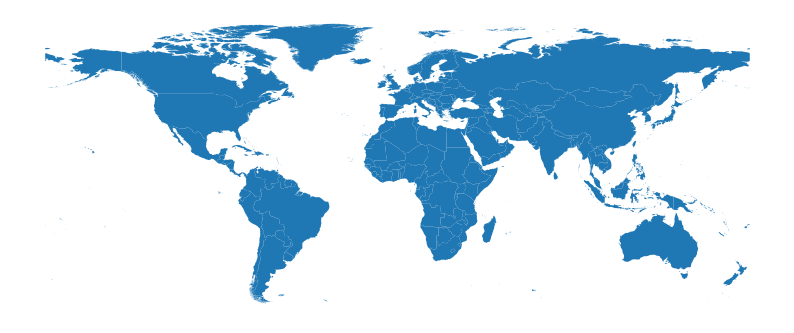

In [8]:
import geopandas as gpd
import matplotlib.pyplot as plt

gdf = gpd.read_file('Burke_et_al/shape/country.shp') # read the shape file
gdf = gdf[~(gdf['FIPS_CNTRY']=='AY')].reset_index() # Drop Antarctica

gdf.plot(figsize=(10, 8))
plt.axis('off')
plt.show()

Now, let's combine the shape data with the country data and display the temperature on the map.

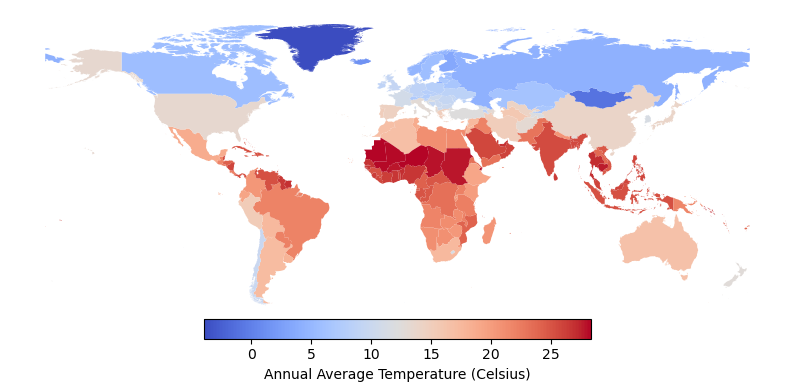

In [14]:
# Convert the panel data (df_panel) into county average using the .groupby method.
ave_tmp = df_panel[['iso', 'UDel_temp_popweight']].groupby('iso').mean().reset_index()
ave_tmp.rename(columns={'iso': 'GMI_CNTRY'}, inplace=True) # Change the name of the country identifier into 'GMI_CNTRY' to align the names of keys used for merge.

# Merge the geo data and the temperature data
gdf = pd.merge(gdf, ave_tmp, on='GMI_CNTRY')
gdf.plot(figsize=(10, 8), cmap='coolwarm', linewidth=0.1, column='UDel_temp_popweight',legend=True, legend_kwds={"label": "Annual Average Temperature (Celsius)", "orientation": "horizontal", "shrink": 0.5, "pad": 0})
plt.axis('off')
plt.show()

Not surprisingly, countries near the equator have very high average temperatures, indicating that there is huge heterogeneity in annual average temperatures among countries.<br><br>
We then pass the panel data to Stata.

In [29]:
import stata_setup
stata_setup.config('/Applications/Stata', 'se') # initialize a Stata session

from pystata import stata

stata.pdataframe_to_data(df_panel, force=True) # load the data into Stata
stata.run('summarize')


    Variable |        Obs        Mean    Std. dev.       Min        Max
-------------+---------------------------------------------------------
         iso |          0
        year |      9,093    1988.951    14.98441       1960       2013
      AgrGDP |      5,861    7.48e+09    2.27e+10          0   3.87e+11
         Pop |      8,935    2.84e+07    1.10e+08       9056   1.36e+09
      TotGDP |      8,175    1.84e+11    8.16e+11   1.66e+07   1.45e+13
-------------+---------------------------------------------------------
  gdpCAP_wdi |      8,167    9175.517    15169.65   50.04221   158802.5
gdpCAPppp_~i |      4,345    14632.59    18198.15   142.0188   138024.9
 countryname |          0
     isocode |          0
   NonAgrGDP |      5,810    1.93e+11    8.76e+11  -1.31e+08   1.37e+13
-------------+---------------------------------------------------------
   growthWDI |      8,054     .019004    .0613317  -.9799127   .8840587
AgrGDPgrowth |      5,707    .0194128    .0937838  -.7493

One of Stata's powerful features is the ability to recognize data as panel data using the <b>xtset</b> command. As you know, once Stata recognizes the panel data, various operations on the panel data can be easily performed.<br>
In our data, `iso` is a panel variable and `year` is a time variable, so we run the following code. (Note that since `iso` is a string variable, we convert it into an integer variable named `iso_n` using the <b>encode</b> command.)

In [30]:
stata.run('''
          encode iso, gen(iso_n)
          xtset iso_n year
          ''')


. 
.           encode iso, gen(iso_n)

.           xtset iso_n year

Panel variable: iso_n (unbalanced)
 Time variable: year, 1960 to 2013
         Delta: 1 unit

.           
. 


Now Stata recognized our data set as a panel data. Recall we can estimate a fixed effect model using the <b>xtreg ... , fe</b> command. Just in case recall the model to be estimated:
$$
Output\;growth_{it}=\beta_0+\beta_1\times Temperature_{it}+\beta_2\times Temperature^2_{it}+Year\;Effect_t+Fixed\;Effect_i+\epsilon_{it}
$$
Remember this specification includes a quadratic term for temperature allowing for the non-linear impact of it on GDP growth.<br><br>
The Stata command for estimation is as follows:

In [31]:
stata.run('xtreg growthWDI c.UDel_temp_popweight##c.UDel_temp_popweight i.year, fe')
# Note that "c.UDel_temp_popweight##c.UDel_temp_popweight" will create both linear and quadratic terms


Fixed-effects (within) regression               Number of obs     =      6,584
Group variable: iso_n                           Number of groups  =        166

R-squared:                                      Obs per group:
     Within  = 0.0804                                         min =          8
     Between = 0.0205                                         avg =       39.7
     Overall = 0.0535                                         max =         50

                                                F(51, 6367)       =      10.92
corr(u_i, Xb) = -0.3722                         Prob > F          =     0.0000

------------------------------------------------------------------------------
   growthWDI | Coefficient  Std. err.      t    P>|t|     [95% conf. interval]
-------------+----------------------------------------------------------------
UDel_temp_~t |   .0083449   .0028802     2.90   0.004     .0026987    .0139911
             |
          c. |
UDel_temp_~t#|
          c. |
UDel

Looking at the coefficient of the squared term for temperature in the above estimation results, the coefficient is negative and statistically significant. This supports our hypothesis, i.e., the higher the temperature, the greater the negative impact of temperature rise on GDP growth.<br><br>
Before visualizing these results on a map, let us first check the magnitude by displaying the marginal effect of temperature on a graph. As with the Land price exercise described before, we can easily calculate marginal effects by using Stata's <b>margins</b> command. This time, however, we use the <b>at()</b> option instead of <b>atmeans</b> to calculate the marginal effect for average temperatures from -5°C to 30°C.

In [32]:
stata.run('margins, dydx(UDel_temp_popweight) at(UDel_temp_popweight=(-5(1)30)) level(90) ')


Average marginal effects                                 Number of obs = 6,584
Model VCE: Conventional

Expression: Linear prediction, predict()
dy/dx wrt:  UDel_temp_popweight
1._at:  UDel_temp_popw~t = -5
2._at:  UDel_temp_popw~t = -4
3._at:  UDel_temp_popw~t = -3
4._at:  UDel_temp_popw~t = -2
5._at:  UDel_temp_popw~t = -1
6._at:  UDel_temp_popw~t =  0
7._at:  UDel_temp_popw~t =  1
8._at:  UDel_temp_popw~t =  2
9._at:  UDel_temp_popw~t =  3
10._at: UDel_temp_popw~t =  4
11._at: UDel_temp_popw~t =  5
12._at: UDel_temp_popw~t =  6
13._at: UDel_temp_popw~t =  7
14._at: UDel_temp_popw~t =  8
15._at: UDel_temp_popw~t =  9
16._at: UDel_temp_popw~t = 10
17._at: UDel_temp_popw~t = 11
18._at: UDel_temp_popw~t = 12
19._at: UDel_temp_popw~t = 13
20._at: UDel_temp_popw~t = 14
21._at: UDel_temp_popw~t = 15
22._at: UDel_temp_popw~t = 16
23._at: UDel_temp_popw~t = 17
24._at: UDel_temp_popw~t = 18
25._at: UDel_temp_popw~t = 19
26._at: UDel_temp_popw~t = 20
27._at: UDel_temp_popw~t = 21
28._at: UDel

As can be seen in the following code, the result of the <b>margins</b> command is stored in <b>r()</b>.

In [33]:
stata.run('return list')


scalars:
              r(level) =  90
               r(k_at) =  1
               r(k_by) =  1
          r(k_predict) =  1
          r(k_margins) =  0
                  r(N) =  6584

macros:
           r(mcmethod) : "noadjust"
                r(cmd) : "margins"
            r(cmdline) : "margins , dydx(UDel_temp_popweight) at(UDel_temp_.."
        r(est_cmdline) : "xtreg growthWDI c.UDel_temp_popweight##c.UDel_tem.."
            r(est_cmd) : "xtreg"
         r(emptycells) : "strict"
          r(atstats36) : "values asobserved asobserved asobserved asobserve.."
          r(atstats35) : "values asobserved asobserved asobserved asobserve.."
          r(atstats34) : "values asobserved asobserved asobserved asobserve.."
          r(atstats33) : "values asobserved asobserved asobserved asobserve.."
          r(atstats32) : "values asobserved asobserved asobserved asobserve.."
          r(atstats31) : "values asobserved asobserved asobserved asobserve.."
          r(atstats30) : "values asobse

We do the visualization on the Python side, so we pass the above estimation results to Python. As described in the previous section, we can store <b>r()</b> results in a Python dictionary using the <b>stata.get_return()</b> function.

In [34]:
r_result = stata.get_return()

<b>r(table)</b> contains the information from the table displayed in the result of the <b>margins</b> command. From this, we get the values of the marginal effects and their 95% confidence intervals. <b>r(table)[0]</b> is the marginal effect, and <b>r(table)[4]</b> and <b>r(table)[5]</b> are the lower and upper limits of the confidence interval.

In [35]:
df_coef = pd.DataFrame({'coef': r_result['r(table)'][0]*100, 'll': r_result['r(table)'][4]*100, 'ul': r_result['r(table)'][5]*100})
# I multiply them by 100 to convert the unit into percentage
df_coef

,coef,ll,ul
0,1.091621,0.497695,1.685547
1,1.040196,0.470991,1.609400
2,0.988770,0.443989,1.533551
3,0.937344,0.416647,1.458042
4,0.885919,0.388917,1.382921
5,0.834493,0.360739,1.308248
6,0.783068,0.332044,1.234091
7,0.731642,0.302751,1.160533
8,0.680216,0.272762,1.087671
9,0.628791,0.241961,1.015621


We have created a dataframe (df_coef) that contains the marginal effect of temperature for each temperature from -5°C to 30°C and its confidence interval. Let's visualize this as follows:

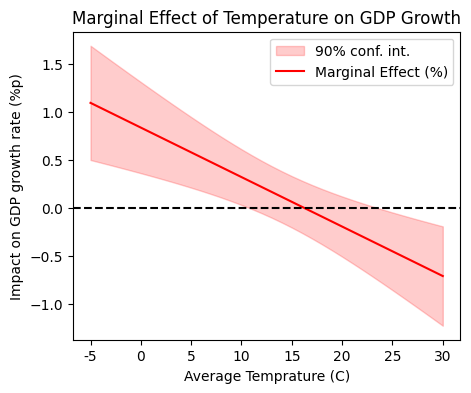

In [36]:
plt.figure(figsize=(5, 4))

# plotting the data
# plt.fill_between() is a very useful function to display confidence intervals creating a shaded area between the upper and lower limits
plt.fill_between(df_coef.index, df_coef['ll'], df_coef['ul'], color='red', alpha=0.2, label='90% conf. int.')
plt.plot(df_coef.index, df_coef['coef'], label='Marginal Effect (%)', color='red')

# legend, title, and labels
plt.legend()
plt.title('Marginal Effect of Temperature on GDP Growth')
plt.xlabel('Average Temprature (C)')
plt.ylabel('Impact on GDP growth rate (%p)')

# plotting zero line
plt.axhline(0, color='black', linewidth=1.5, linestyle='--')

# creating xticks 
xticks_positions = [0, 5, 10, 15, 20, 25, 30, 35]
xticks_labels = ['-5', '0', '5', '10', '15', '20', '25', '30']
plt.xticks(xticks_positions, xticks_labels)

plt.show()

The above graph shows that the marginal effect of temperature on GDP growth rate is dependent on temperature. For example, in a country with an average temperature of about 16°C, the effect of a temperature increase is almost zero, while in a country with an average temperature of 25°C, a 1°C temperature increase will push GDP growth rate down roughly 0.5%p.<br><br>
Finally, we visualize this marginal effect on the world map. We first calculate the marginal effect by country, using the average temperature for each country. (The <b>over()</b> option allows for the marginal effect estimation by category.)

In [37]:
stata.run('margins, dydx(UDel_temp_popweight) at((mean) UDel_temp_popweight) over(iso_n)')


Average marginal effects                                 Number of obs = 6,584
Model VCE: Conventional

Expression: Linear prediction, predict()
dy/dx wrt:  UDel_temp_popweight
Over:       iso_n
At: 3.iso_n
        UDel_temp_popweight =   13.1275 (mean)
    4.iso_n
        UDel_temp_popweight =   22.0548 (mean)
    5.iso_n
        UDel_temp_popweight =    13.419 (mean)
    6.iso_n
        UDel_temp_popweight =    26.916 (mean)
    7.iso_n
        UDel_temp_popweight =  17.22543 (mean)
    8.iso_n
        UDel_temp_popweight =    8.3705 (mean)
    10.iso_n
        UDel_temp_popweight =   16.5526 (mean)
    11.iso_n
        UDel_temp_popweight =    7.7052 (mean)
    12.iso_n
        UDel_temp_popweight =    12.972 (mean)
    13.iso_n
        UDel_temp_popweight =   20.2312 (mean)
    14.iso_n
        UDel_temp_popweight =    9.9498 (mean)
    15.iso_n
        UDel_temp_popweight =   27.1094 (mean)
    16.iso_n
        UDel_temp_popweight =    27.852 (mean)
    17.iso_n
        UDel_temp

As mentioned earlier, the result of the <b>margins</b> command is stored in <b>r()</b>.

In [38]:
stata.run('return list')


scalars:
              r(level) =  95
               r(k_at) =  1
               r(k_by) =  166
          r(k_predict) =  1
          r(k_margins) =  0
                  r(N) =  6584

macros:
           r(mcmethod) : "noadjust"
                r(cmd) : "margins"
            r(cmdline) : "margins , dydx(UDel_temp_popweight) at((mean) UDe.."
        r(est_cmdline) : "xtreg growthWDI c.UDel_temp_popweight##c.UDel_tem.."
            r(est_cmd) : "xtreg"
         r(emptycells) : "strict"
           r(atstats1) : "mean asobserved asobserved asobserved asobserved .."
              r(by166) : "201.iso_n"
              r(by165) : "200.iso_n"
              r(by164) : "199.iso_n"
              r(by163) : "198.iso_n"
              r(by162) : "197.iso_n"
              r(by161) : "196.iso_n"
              r(by160) : "194.iso_n"
              r(by159) : "193.iso_n"
              r(by158) : "192.iso_n"
              r(by157) : "191.iso_n"
              r(by156) : "190.iso_n"
              r(by155) : 

Again use the <b>stata.get_return()</b> function to store this result in the Python dictionary.

In [39]:
r_result = stata.get_return()

One problem is that the marginal effects for each country in the output are not tied to the ISO country code (because on Stata the ISO code is encoded as an integer value). When merging with the map data we need the ISO code, so the following code ties the estimated marginal effects to the ISO code. However, since this is a problem specific to this exercise, you can ignore the details in the following code.

In [40]:
# r() contains the information about iso_n (integer country code) The following code retrieves it from r_result
iso_n = [int(r_result[f'r(by{i})'].replace(".iso_n", "")) for i in range(1, 167)]

# Retrieve marginal effect from r_result
df_me = pd.DataFrame({'iso_n': iso_n, 'ME': r_result['r(b)'][0]})

# From Stata, retrieve the mapping between iso (3-letter code) and iso_n (integer)
df_iso = stata.pdataframe_from_frame('default', var=['iso', 'iso_n'])
df_iso = df_iso.drop_duplicates().reset_index() # Since the data is panel, I collapse it by dropping duplicates

# Combine the marginal effect and the 3-letter iso
df_me = pd.merge(df_me, df_iso, on='iso_n')

# Convert the unit of marginal effect into percent
df_me['ME'] = df_me['ME']*100

# Show the result
df_me

,iso_n,ME,index,iso
0,3,0.159404,53,AFG
1,4,-0.299688,64,AGO
2,5,0.144413,107,ALB
3,6,-0.549678,150,ARE
4,7,-0.051335,187,ARG
...,...,...,...,...
161,197,-0.354467,8854,YEM
162,198,-0.062493,8878,ZAF
163,199,-0.360411,8932,ZAR
164,200,-0.254958,8985,ZMB


As mentioned above, we have created a data frame that combines marginal effects and ISO codes. Finally, let's merge this into a geodataframe of the world map and visualize it.

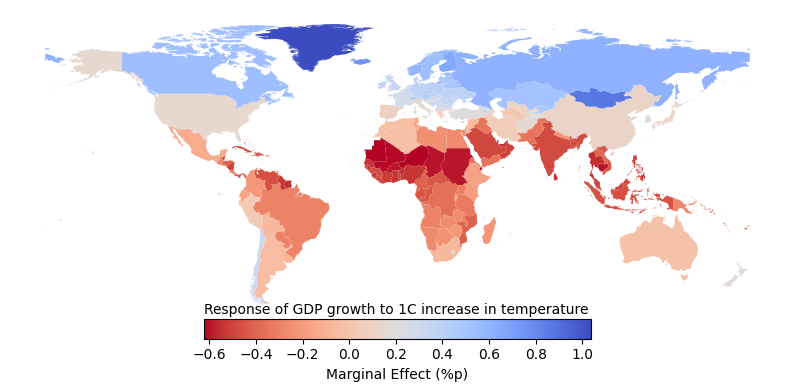

In [41]:
df_me.rename(columns={'iso': 'GMI_CNTRY'}, inplace=True)  # Change the name of the country identifier to align the names of keys used for merge.

gdf = pd.merge(gdf, df_me, on='GMI_CNTRY')
gdf.plot(figsize=(10, 8), cmap='coolwarm_r', linewidth=0.1, column='ME',legend=True, legend_kwds={"label": "Marginal Effect (%p)", "orientation": "horizontal", "shrink": 0.5, "pad": 0})
plt.text(-99, -60, 'Response of GDP growth to 1C increase in temperature')
plt.axis('off')

plt.show()

The visualization result above shows that the impact of rising temperatures varies greatly from country to country. While developed countries such as North America and Europe are not much affected by temperature rise, developing countries such as Africa, Latin America, and Southeast Asia are significantly affected. Especially, in the most affected regions, a 1°C temperature increase has the effect of reducing GDP growth by about 1%.<br><br><br>
To summarize, using Stata is very useful for advanced econometric analysis such as panel data estimation and calculating marginal effects. On the other hand, Python has the edge when it comes to data manipulation and visualization. As in the above analysis, the proper combination of both is very useful for advanced data analysis.
